#DATA PREPARATION

In [2]:
!pip install gdown
!gdown --id 19AzCVhu2H46C7JEQljbWPE78m3fGrM5K

# Unzip the file
!unzip -q dataset.zip

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:132: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=19AzCVhu2H46C7JEQljbWPE78m3fGrM5K
From (redirected): https://drive.google.com/uc?id=19AzCVhu2H46C7JEQljbWPE78m3fGrM5K&confirm=t&uuid=df8fb1f2-c13c-4d1e-9801-9e343dde5b6e
To: /content/dataset.zip
100% 810M/810M [00:16<00:00, 49.3MB/s]


In [4]:
import os
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Model
from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Activation, Dropout, Flatten, Dense, MaxPooling2D, BatchNormalization
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

In [14]:
TRAINING_DIR = '/content/dataset/TRAIN'
VALIDATION_DIR = '/content/dataset/TEST'

training_datagen = ImageDataGenerator(
    rescale=1./255,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.15,
    zoom_range=0.2,
    fill_mode='nearest',
    brightness_range=[0.5, 1.5],
    channel_shift_range=20,
)

validation_datagen = ImageDataGenerator(
    rescale = 1./255
)

train_generator = training_datagen.flow_from_directory(
    TRAINING_DIR,
    target_size = (224,224),
    class_mode = 'categorical',
    batch_size = 20,
    color_mode='rgb'
)

validation_generator = validation_datagen.flow_from_directory(
    VALIDATION_DIR,
    target_size = (224,224),
    class_mode = 'categorical',
    batch_size = 20,
    color_mode='rgb'
)

Found 1480 images belonging to 10 classes.
Found 200 images belonging to 10 classes.


In [6]:
motivs = train_generator.class_indices
print(motivs)

{'Batik Bali': 0, 'Batik Betawi': 1, 'Batik Blekok': 2, 'Batik Cendrawasih': 3, 'Batik Geblek Renteng': 4, 'Batik Kawung': 5, 'Batik Lasem': 6, 'Batik Megamendung': 7, 'Batik Parang': 8, 'Batik Sekar Jagad': 9}


#MODEL

In [ ]:
## Menggunakan MobileNetV2

In [7]:
#pretrained model
tf.keras.backend.clear_session()
mobilenet = MobileNetV2(include_top=False,
    weights='imagenet',
    input_shape=(224, 224, 3),
    alpha=1.0,
    pooling='avg')

mobilenet.trainable = False

9406464/9406464 [==============================] - 0s 0us/step


In [8]:
def scheduler(epoch, lr):
  if epoch <= 10:
    return lr
  elif 10 < epoch <= 20:
    return lr * tf.math.exp(-0.1)
  else:
    return lr * tf.math.exp(-0.2)

lr_callback = tf.keras.callbacks.LearningRateScheduler(scheduler)

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5)

In [9]:
model = Sequential([
    mobilenet,
    BatchNormalization(),
    Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l1_l2(l1=1e-5, l2=1e-4)),
    Dropout(0.5),
    Dense(10, activation='softmax')
])

model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobilenetv2_1.00_224 (Func  (None, 1280)              2257984   
 tional)                                                         
                                                                 
 batch_normalization (Batch  (None, 1280)              5120      
 Normalization)                                                  
                                                                 
 dense (Dense)               (None, 512)               655872    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 10)                5130      
                                                                 
Total params: 2924106 (11.15 MB)
Trainable params: 66356

##MODEL TRAINING

In [15]:
TRAIN_STEP = 1480//20
VALIDATION_STEP = 200//20
epochs = 50

In [16]:
history = model.fit(
    train_generator,
    validation_data=validation_generator,
    steps_per_epoch=TRAIN_STEP,
    validation_steps=VALIDATION_STEP,
    shuffle=True,
    epochs=epochs,
    callbacks=[lr_callback, early_stopping]
)

Epoch 1/50
74/74 [==============================] - 98s 1s/step - loss: 1.5028 - accuracy: 0.5953 - val_loss: 1.1341 - val_accuracy: 0.7300 - lr: 1.0000e-04
Epoch 2/50
74/74 [==============================] - 104s 1s/step - loss: 1.2680 - accuracy: 0.6662 - val_loss: 1.0046 - val_accuracy: 0.7400 - lr: 1.0000e-04
Epoch 3/50
74/74 [==============================] - 100s 1s/step - loss: 1.2081 - accuracy: 0.6831 - val_loss: 0.9239 - val_accuracy: 0.7400 - lr: 1.0000e-04
Epoch 4/50
74/74 [==============================] - 110s 1s/step - loss: 1.0376 - accuracy: 0.7493 - val_loss: 0.8619 - val_accuracy: 0.7850 - lr: 1.0000e-04
Epoch 5/50
74/74 [==============================] - 103s 1s/step - loss: 1.0069 - accuracy: 0.7500 - val_loss: 0.8315 - val_accuracy: 0.7850 - lr: 1.0000e-04
Epoch 6/50
74/74 [==============================] - 105s 1s/step - loss: 0.9457 - accuracy: 0.7574 - val_loss: 0.8035 - val_accuracy: 0.8000 - lr: 1.0000e-04
Epoch 7/50
74/74 [==============================] - 1

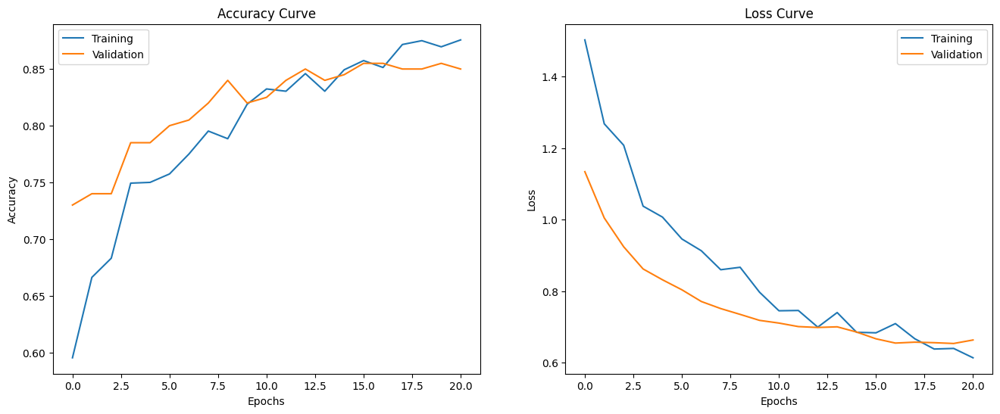

In [17]:
train_acc = history.history['accuracy']
train_loss = history.history['loss']
val_acc = history.history['val_accuracy']
val_loss = history.history['val_loss']

plt.figure(figsize=(16,6))
plt.subplot(1, 2, 1)
plt.title('Accuracy Curve')
plt.plot(train_acc, label='Training')
plt.plot(val_acc, label='Validation')
plt.legend()
plt.xlabel('Epochs')
plt.ylabel('Accuracy')

plt.subplot(1, 2, 2)
plt.title('Loss Curve')
plt.plot(train_loss, label='Training')
plt.plot(val_loss, label='Validation')
plt.legend()
plt.xlabel('Epochs')
plt.ylabel('Loss')

plt.show()

##Model Testing

Batik Bali Predictions --> 13/20 correct
Batik Betawi Predictions --> 17/20 correct
Batik Blekok Predictions --> 20/20 correct
Batik Cendrawasih Predictions --> 16/20 correct
Batik Geblek Renteng Predictions --> 17/20 correct
Batik Kawung Predictions --> 20/20 correct
Batik Lasem Predictions --> 12/20 correct
Batik Megamendung Predictions --> 19/20 correct
Batik Parang Predictions --> 16/20 correct
Batik Sekar Jagad Predictions --> 20/20 correct


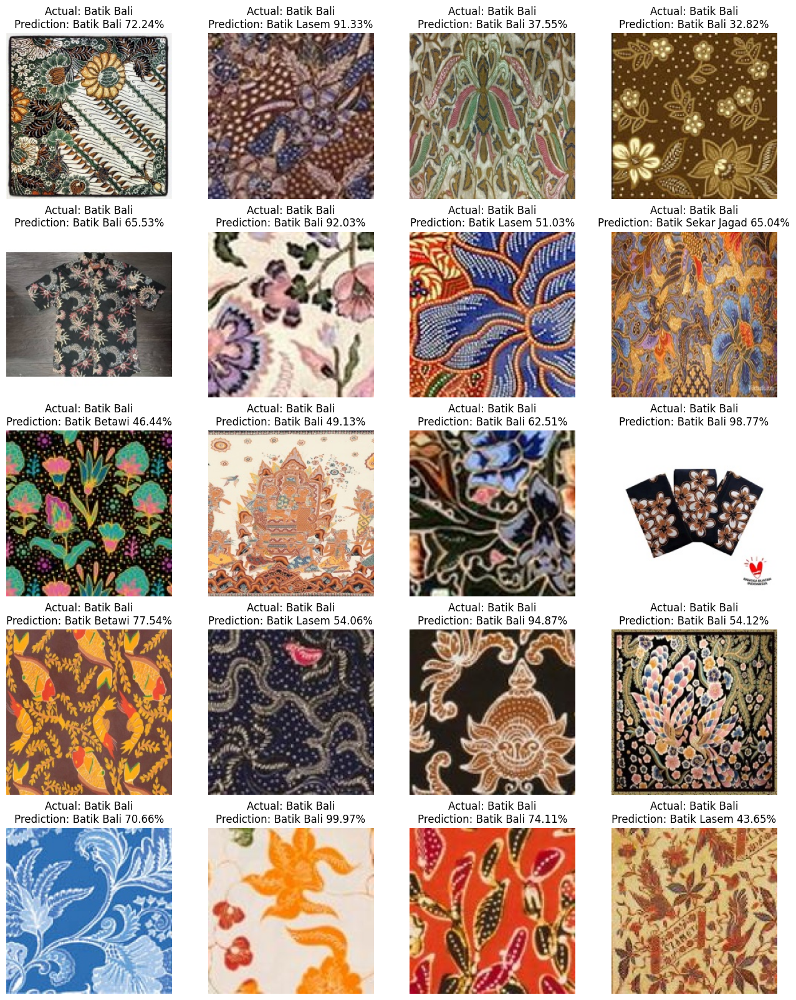

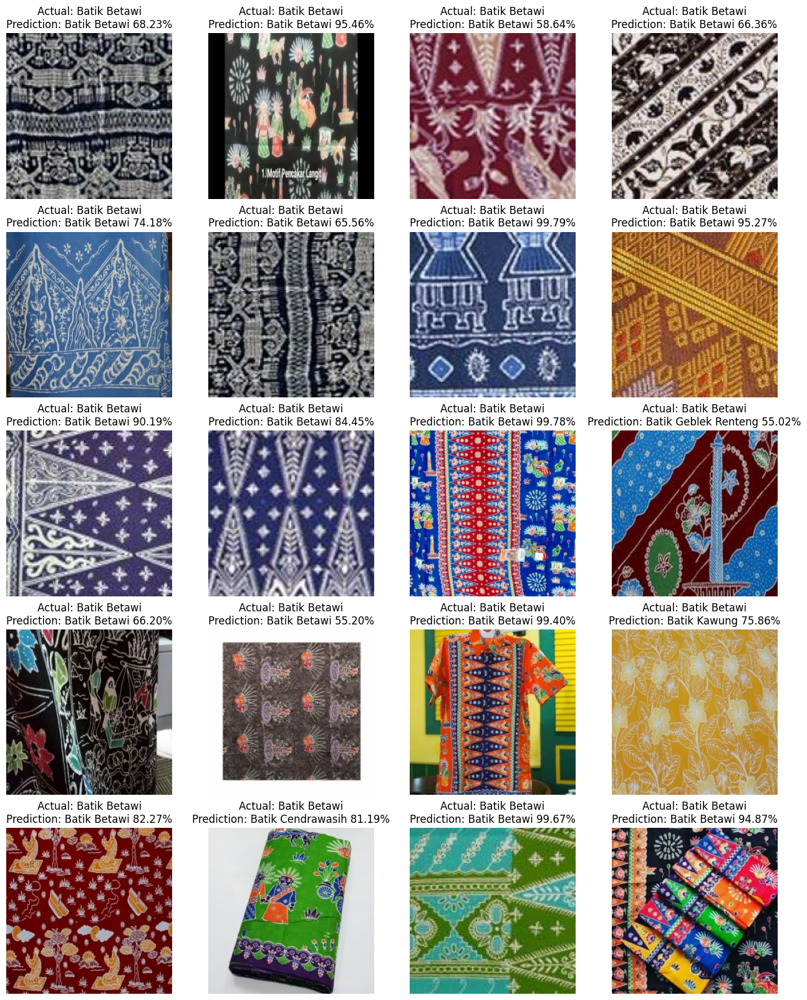

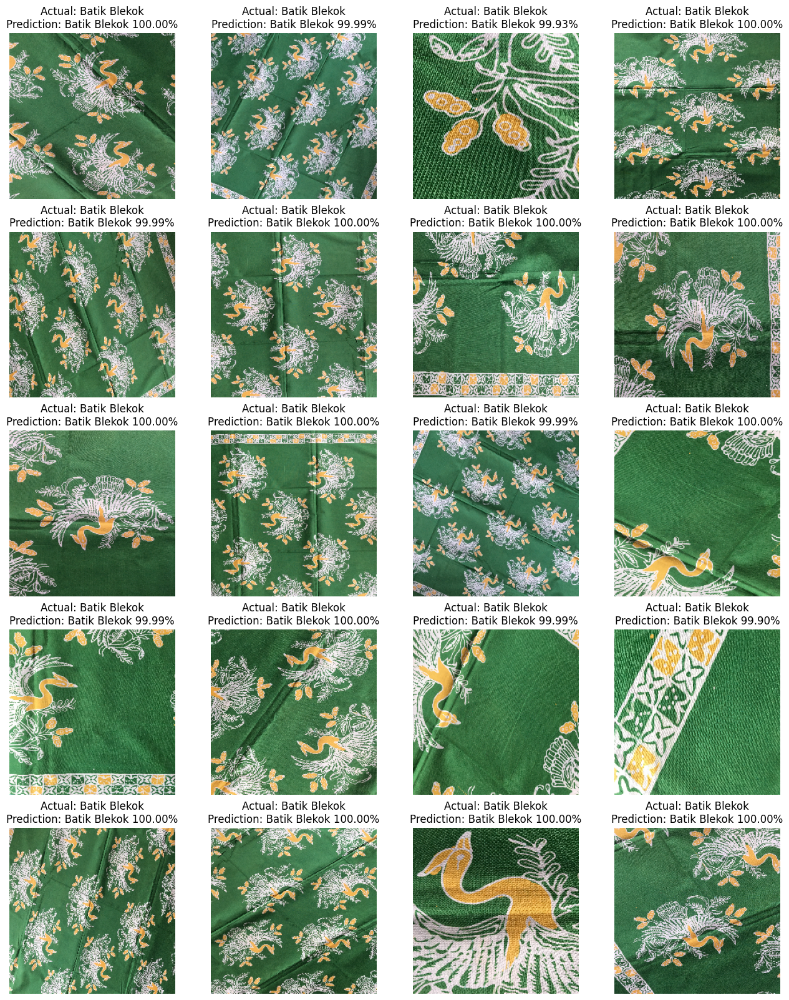

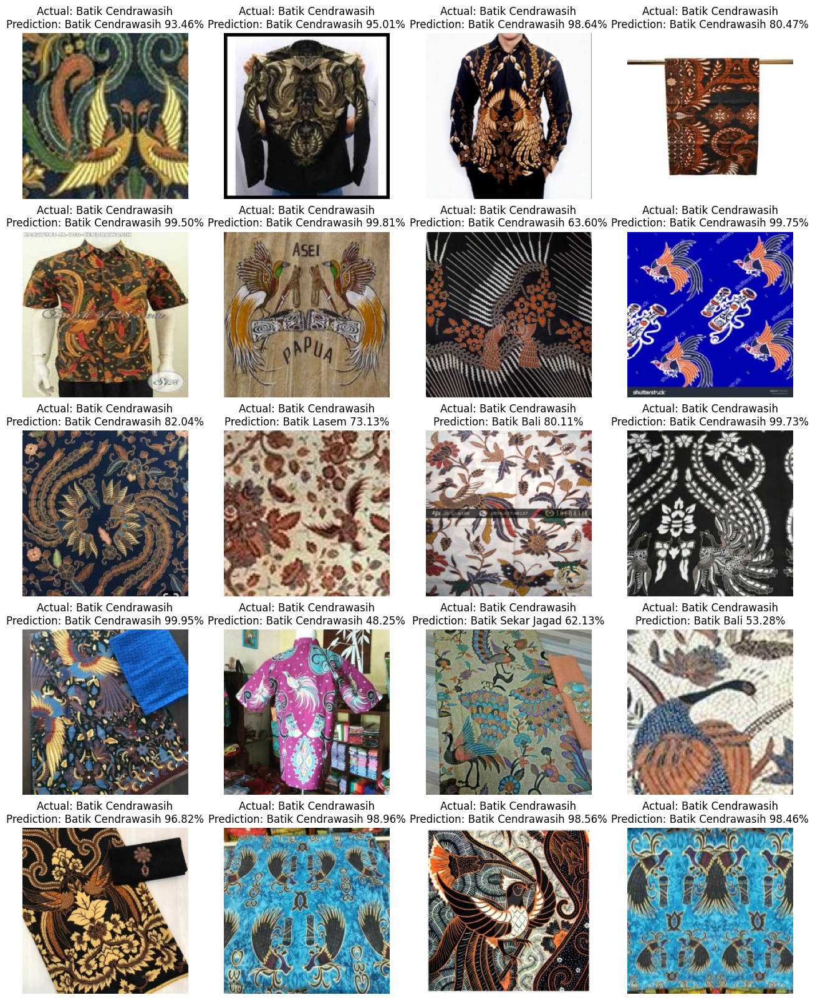

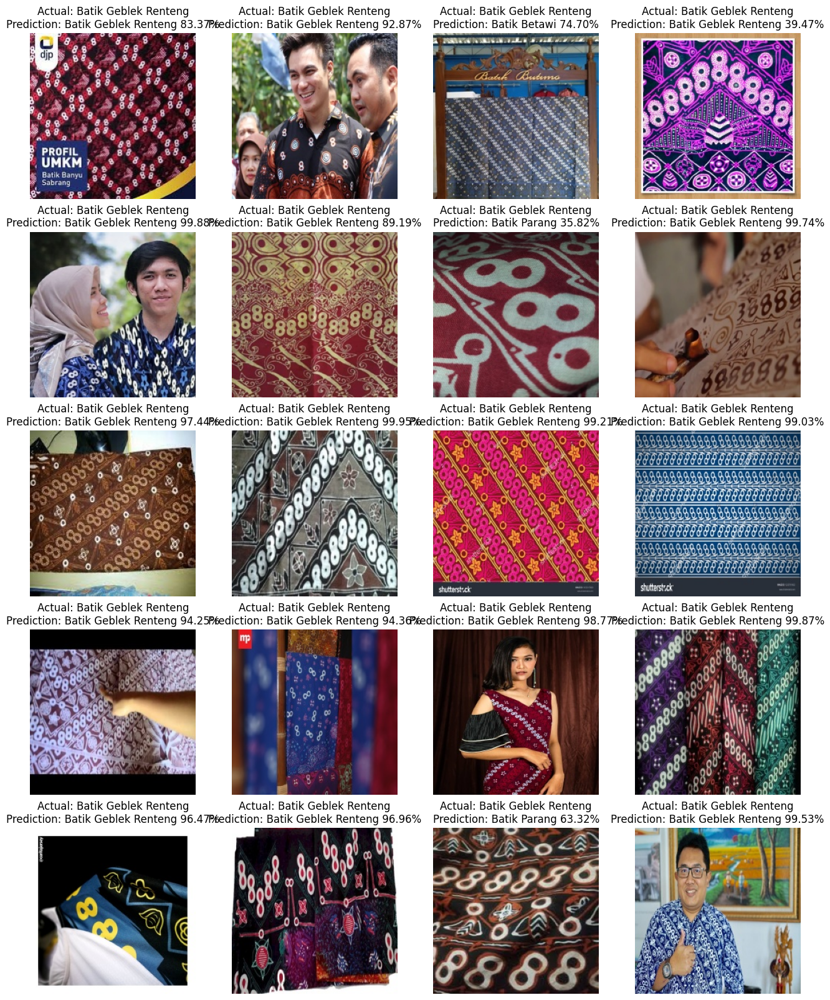

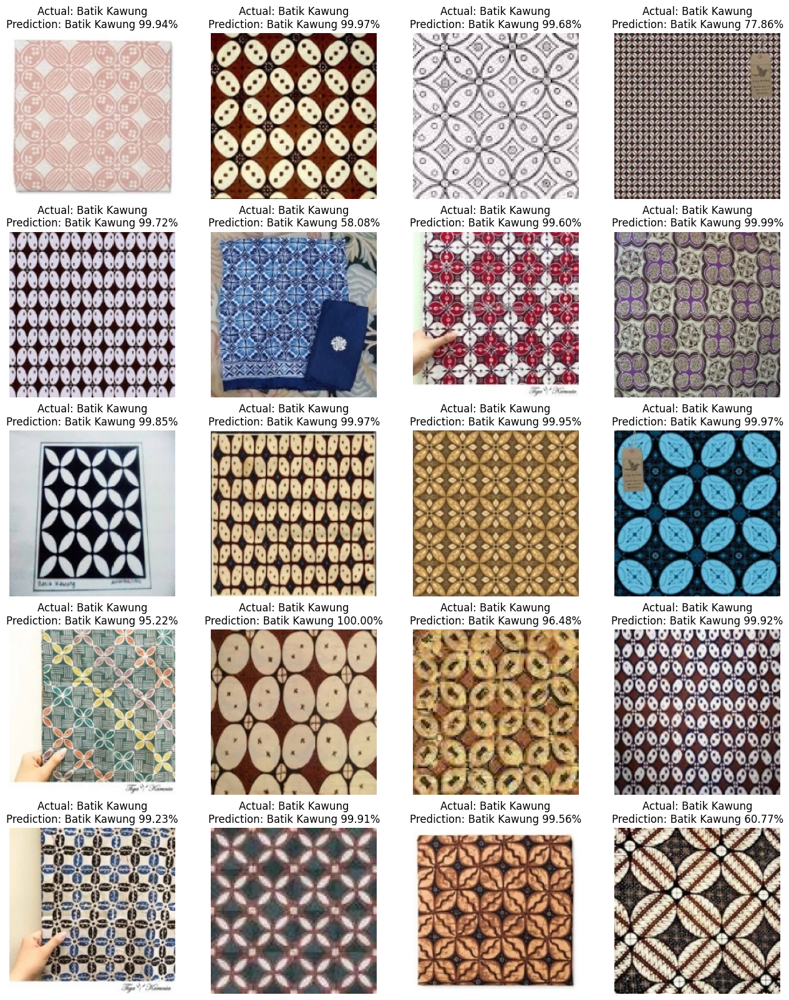

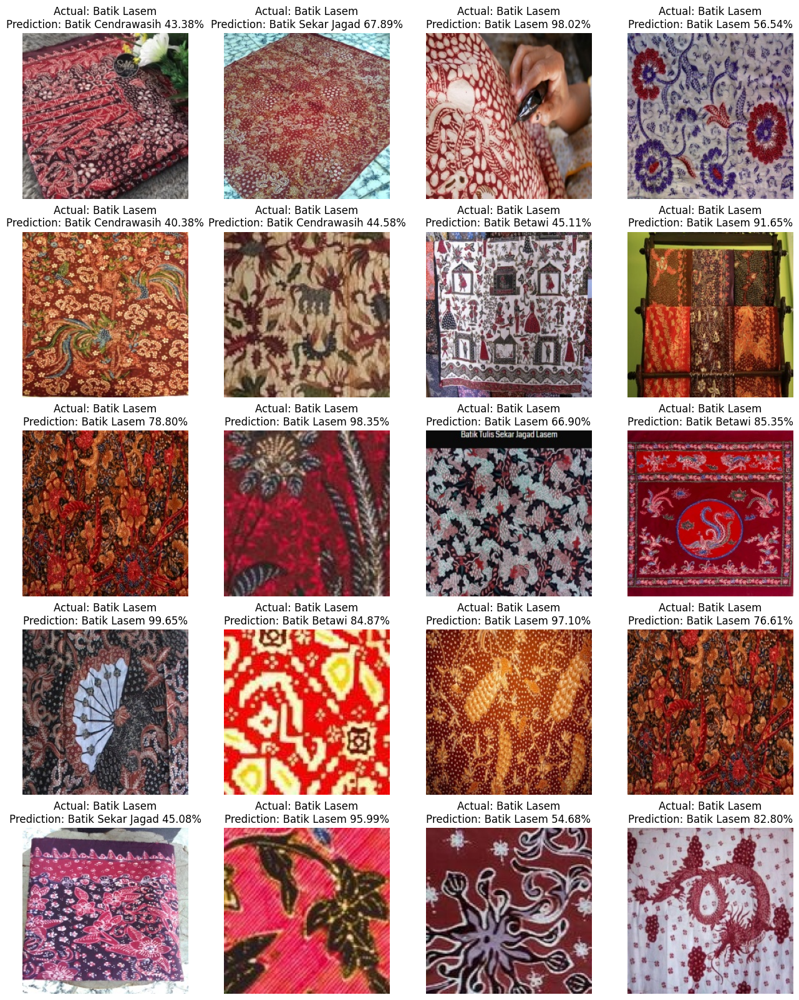

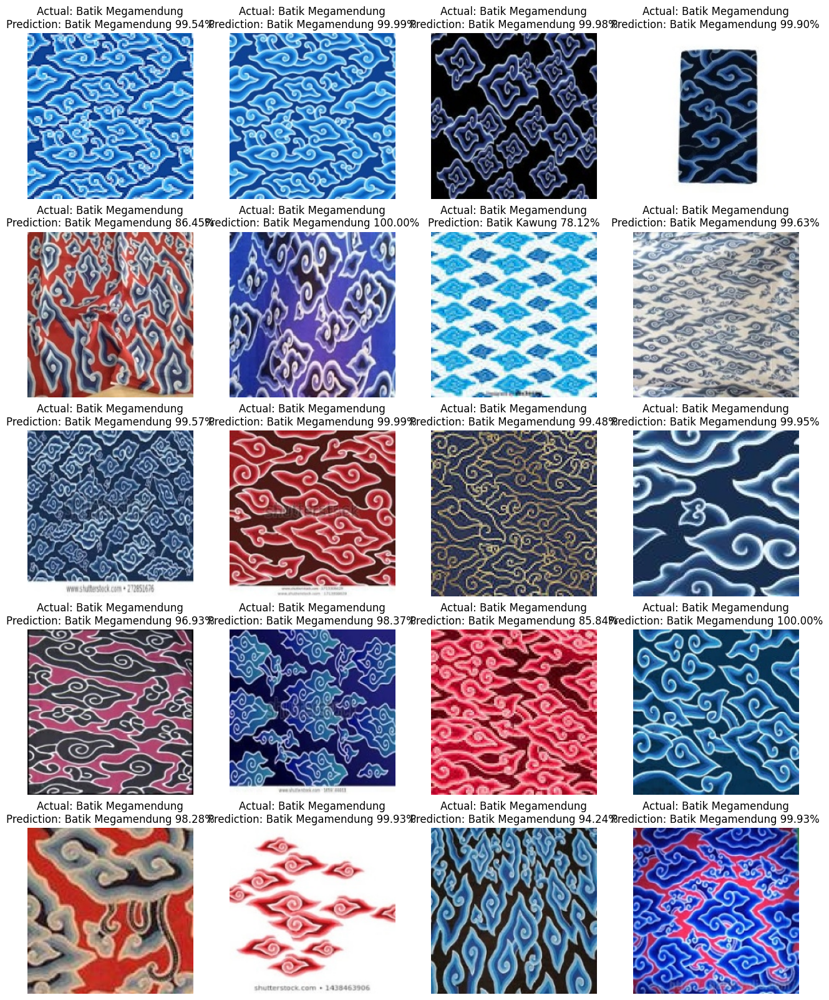

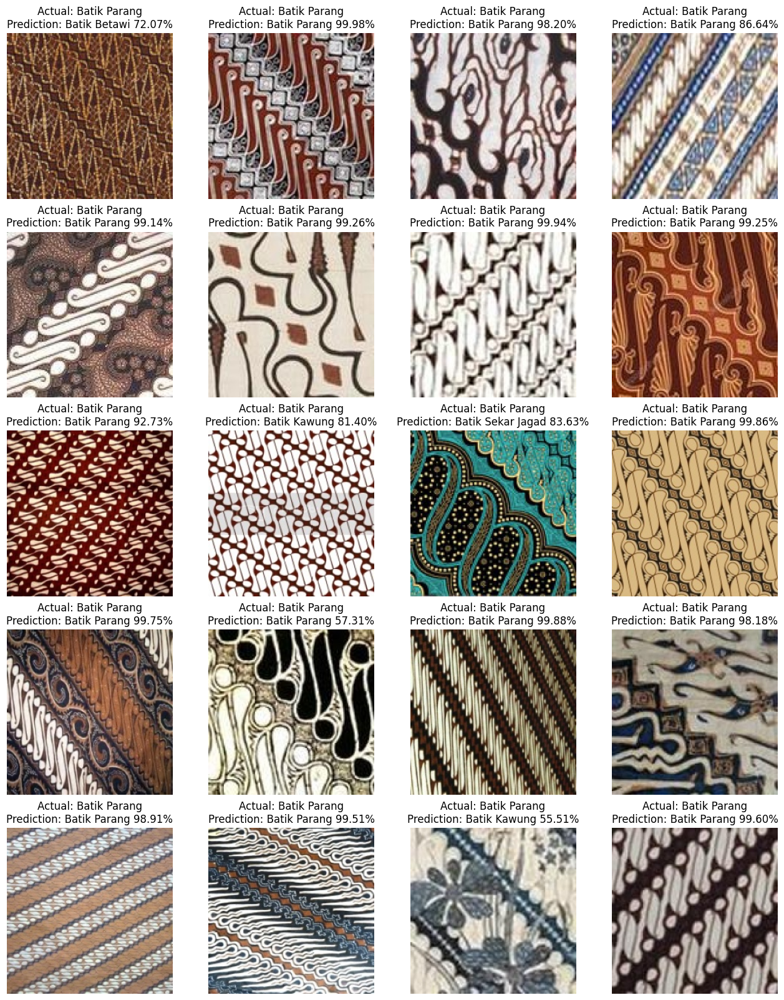

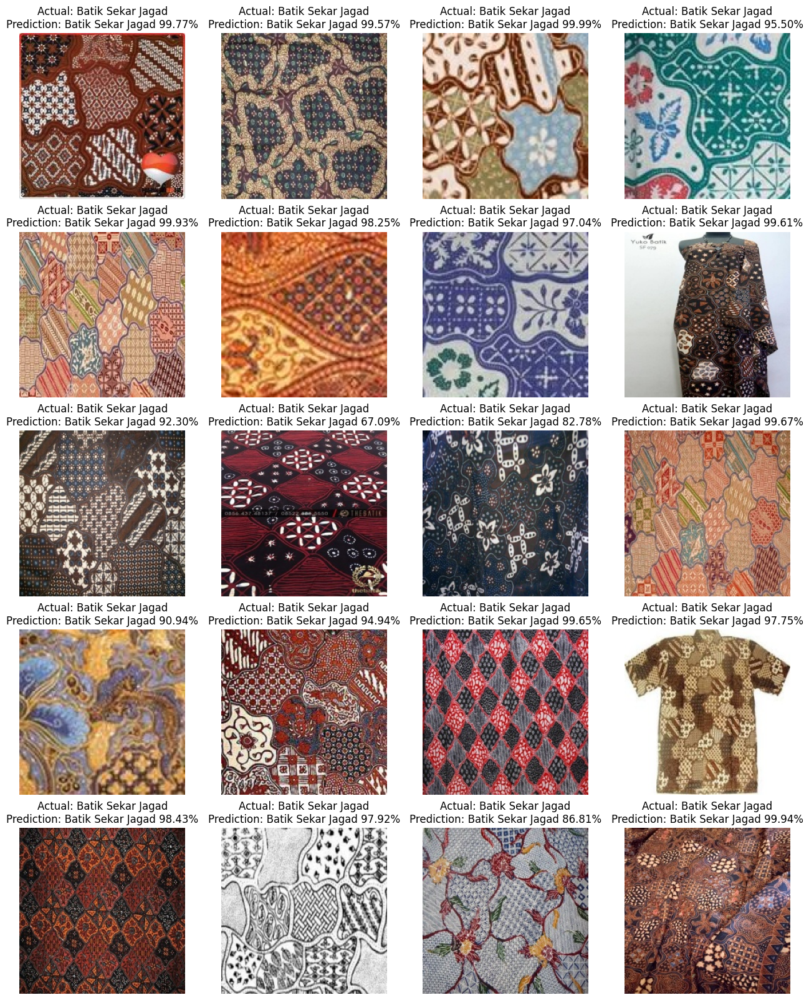

In [20]:
test_dir = '/content/dataset/TEST'

for motive in motivs.keys():
    images_list = os.listdir(os.path.join(test_dir, motive))
    plt.figure(figsize=(16, 20))

    correct_count = 0

    for idx, image in enumerate(images_list):
        img_path = f'/content/dataset/TEST/{motive}/{image}'
        img = load_img(img_path, target_size=(224, 224))

        img_array = img_to_array(img) / 255.0
        img_array = tf.expand_dims(img_array, 0)

        motives_list = list(motivs.keys())
        prediction = model(img_array)
        pred_idx = np.argmax(prediction)
        pred_motive = motives_list[pred_idx]
        pred_confidence = prediction[0][pred_idx] * 100

        if pred_motive == motive:
            correct_count += 1

        plt.subplot(5, 4, idx+1)
        plt.title(f'Actual: {motive}\nPrediction: {pred_motive} {pred_confidence:.2f}%')
        plt.imshow(img)
        plt.axis('off')

    print(f'{motive} Predictions --> {correct_count}/20 correct')
plt.show()

#Save Model

In [21]:
import tensorflow as tf
from google.colab import files

model.save('model_MobilNetV2.h5')

# Unduh file melalui browser
files.download('model_MobilNetV2.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>